In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.8/993.8 kB 27.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 72.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 59.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 19.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 99.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
import os
from ultralytics import YOLO
from google.colab import drive
import random
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import glob
from pathlib import Path
from IPython.display import Image, display

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
dataset_path = '/content/drive/MyDrive/CIN/datasetCIN'

In [ ]:
print("Contenu de train/images :")
print(os.listdir(os.path.join(dataset_path, "train", "images"))[:5])

print("Contenu de valid/labels :")
print(os.listdir(os.path.join(dataset_path, "valid", "labels"))[:5])


Contenu de train/images :
['cin111_back_jpg.rf.f9db0feef2d2879b12b0f3114dd8e5ac.jpg', 'abandoned-factory-background-designify-1-_png_jpg.rf.ec4f4f38b532c5b767953dd858ce3e37.jpg', 'cin111_back_jpg.rf.58069d5c58dd491e28897fd586f244c9.jpg', 'cin111_back_jpg.rf.adcd799738efada01a2d52ac8a0e8383.jpg', 'CIN-1_jpg.rf.8dfd734537f165b3b51cb360c542ba3d.jpg']
Contenu de valid/labels :
['C10_jpg.rf.8d2e328c5e8b9c8aa39ab73dd22063e9.txt', 'cin142_jpg.rf.01487b74b0900c23c291d147d58d8f0d.txt', 'C13_jpg.rf.8ba84b63f151073254f89e20d8200ddb.txt', 'cin13_jpg.rf.0a64fcd963947e326161b46a32af3630.txt', 'C16_jpg.rf.567ec4da568e1eaad697c711a9df1dfd.txt']


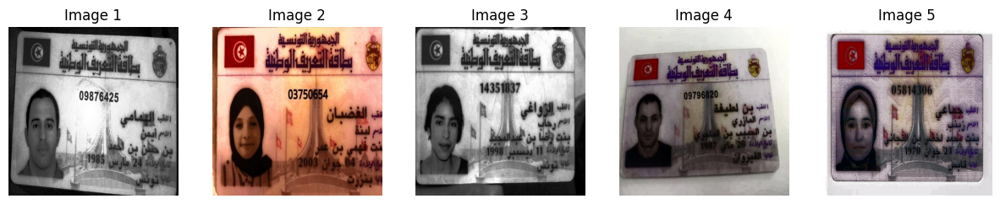

In [ ]:
train_images_dir = "/content/drive/MyDrive/CIN/datasetCIN/train/images"

# Liste des fichiers image dans le dossier
image_files = os.listdir(train_images_dir)

# Sélectionner 5 images au hasard
sample_images = random.sample(image_files, 5)

# Afficher les images
plt.figure(figsize=(15, 10))
for i, img_file in enumerate(sample_images):
    img_path = os.path.join(train_images_dir, img_file)
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour un affichage correct avec matplotlib

    plt.subplot(1, 5, i + 1)
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.title(f"Image {i+1}")

plt.show()

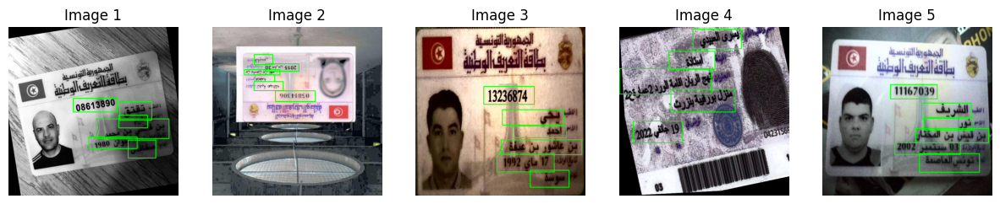

In [ ]:
train_labels_dir = "/content/drive/MyDrive/CIN/datasetCIN/train/labels"

# Liste des fichiers image
image_files = os.listdir(train_images_dir)

# Sélectionner 5 images au hasard
sample_images = random.sample(image_files, 5)

# Afficher les images et annotations
plt.figure(figsize=(15, 10))
for i, img_file in enumerate(sample_images):
    img_path = os.path.join(train_images_dir, img_file)
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Charger les annotations
    label_file = os.path.splitext(img_file)[0] + ".txt"
    label_path = os.path.join(train_labels_dir, label_file)

    # Lire les annotations YOLO
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            annotations = f.readlines()

        # Dessiner les boîtes de détection sur l'image
        for annotation in annotations:
            parts = annotation.strip().split()
            class_id = int(parts[0])
            x_center, y_center, width, height = map(float, parts[1:])
            # Convertir en pixels
            img_height, img_width = img.shape[:2]
            x_center = int(x_center * img_width)
            y_center = int(y_center * img_height)
            width = int(width * img_width)
            height = int(height * img_height)

            # Calculer les coordonnées de la boîte de détection
            x1 = x_center - width // 2
            y1 = y_center - height // 2
            x2 = x_center + width // 2
            y2 = y_center + height // 2

            # Dessiner la boîte sur l'image
            cv2.rectangle(img_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Boîte verte

    # Afficher l'image avec les annotations
    plt.subplot(1, 5, i + 1)
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.title(f"Image {i+1}")

plt.show()

In [ ]:
# Définir tes classes
classes = ['Id', 'address', 'dob', 'first_name', 'full_name', 'issue_date', 'last_name', 'mother_name', 'pob', 'profession']

# Créer le fichier dataset.yaml
yaml_content = f"""
# YOLOv8 dataset configuration
path: {os.path.abspath(dataset_path)}
train: train/images
val: valid/images
test: test/images

# Classes
nc: {len(classes)}
names: {classes}
"""

# Chemin pour sauvegarder ton fichier .yaml
yaml_path = os.path.join(dataset_path, "dataset.yaml")

# Sauvegarder le fichier .yaml
with open(yaml_path, 'w') as f:
    f.write(yaml_content)

print(f"Fichier dataset.yaml créé à {yaml_path}")


Fichier dataset.yaml créé à /content/drive/MyDrive/CIN/datasetCIN/dataset.yaml


In [ ]:
def train_yolo(model_type="yolov8n", dataset_yaml_path="/content/drive/MyDrive/CIN/datasetCIN/dataset.yaml", epochs=50, img_size=640, batch_size=16, device='0'):
    model = YOLO(f'{model_type}.pt')
    results = model.train(
        data=dataset_yaml_path,
        epochs=epochs,
        imgsz=img_size,
        batch=batch_size,
        device=device
    )
    return model

dataset_yaml_path = '/content/drive/MyDrive/CIN/datasetCIN/dataset.yaml'
detection_model = train_yolo(model_type="yolov8n", dataset_yaml_path=dataset_yaml_path)


100%|██████████| 6.25M/6.25M [00:00<00:00, 115MB/s]


Ultralytics 8.3.102 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/MyDrive/CIN/datasetCIN/dataset.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show

100%|██████████| 755k/755k [00:00<00:00, 27.7MB/s]


Overriding model.yaml nc=80 with nc=10

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 106MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/CIN/datasetCIN/train/labels.cache... 1077 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1077/1077 [00:00<?, ?it/s]

WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 34, len(boxes) = 6107. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/CIN/datasetCIN/valid/labels.cache... 94 images, 0 backgrounds, 0 corrupt: 100%|██████████| 94/94 [00:00<?, ?it/s]

WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 6, len(boxes) = 545. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.15G      2.195      3.669      1.905         41        640: 100%|██████████| 68/68 [00:45<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.32it/s]

                   all         94        545      0.821      0.165       0.43      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.61G      1.745       1.99      1.472         54        640: 100%|██████████| 68/68 [00:23<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]

                   all         94        545      0.759      0.812      0.846       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.62G       1.69      1.654      1.427         49        640: 100%|██████████| 68/68 [00:22<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.91it/s]

                   all         94        545      0.791      0.871       0.88      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.62G      1.647       1.47      1.379         26        640: 100%|██████████| 68/68 [00:24<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.19it/s]

                   all         94        545      0.868      0.849      0.919      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.62G      1.633      1.351      1.394         65        640: 100%|██████████| 68/68 [00:24<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.24it/s]

                   all         94        545      0.819      0.912      0.895      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.62G      1.622      1.317      1.393         33        640: 100%|██████████| 68/68 [00:24<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.70it/s]

                   all         94        545      0.886      0.834      0.901      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.62G      1.605      1.233      1.363         38        640: 100%|██████████| 68/68 [00:22<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.30it/s]

                   all         94        545      0.859      0.893      0.898      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.62G      1.586      1.189      1.372         46        640: 100%|██████████| 68/68 [00:22<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.34it/s]

                   all         94        545      0.877      0.915      0.926      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.64G      1.581      1.122      1.367         36        640: 100%|██████████| 68/68 [00:24<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.21it/s]

                   all         94        545      0.854      0.907      0.924      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.64G      1.575        1.1      1.361         26        640: 100%|██████████| 68/68 [00:24<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.41it/s]

                   all         94        545      0.885      0.913      0.934      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.64G      1.544      1.069      1.349         52        640: 100%|██████████| 68/68 [00:23<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         94        545      0.886      0.886       0.92      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.66G      1.573      1.043      1.366         52        640: 100%|██████████| 68/68 [00:22<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.70it/s]

                   all         94        545       0.88      0.916      0.916      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.66G      1.553      1.021       1.36         31        640: 100%|██████████| 68/68 [00:23<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.49it/s]

                   all         94        545      0.858      0.913      0.921       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.66G      1.553      1.024      1.364         55        640: 100%|██████████| 68/68 [00:24<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.41it/s]

                   all         94        545      0.883      0.901      0.924      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.68G      1.543     0.9836      1.344         47        640: 100%|██████████| 68/68 [00:24<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.34it/s]

                   all         94        545      0.883      0.935      0.944      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.68G      1.541     0.9621      1.338         57        640: 100%|██████████| 68/68 [00:24<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.21it/s]

                   all         94        545       0.87      0.917      0.921      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.69G      1.529     0.9645      1.341         48        640: 100%|██████████| 68/68 [00:22<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.12it/s]

                   all         94        545      0.882      0.933      0.939      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.69G      1.537     0.9565      1.351         31        640: 100%|██████████| 68/68 [00:23<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.31it/s]

                   all         94        545      0.881      0.913       0.93      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.69G      1.528     0.9255      1.343         65        640: 100%|██████████| 68/68 [00:24<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.48it/s]

                   all         94        545      0.915      0.921      0.937      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.71G      1.523     0.9271      1.348         40        640: 100%|██████████| 68/68 [00:23<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.29it/s]

                   all         94        545      0.913      0.931      0.939      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.71G      1.516     0.9095      1.338         42        640: 100%|██████████| 68/68 [00:22<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.55it/s]

                   all         94        545      0.911      0.881      0.937      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.71G      1.506     0.9068      1.337         39        640: 100%|██████████| 68/68 [00:22<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.28it/s]

                   all         94        545      0.873      0.954      0.937      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.73G      1.501      0.881      1.331         33        640: 100%|██████████| 68/68 [00:23<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.54it/s]

                   all         94        545      0.903      0.952      0.938      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.73G      1.502     0.8835      1.333         44        640: 100%|██████████| 68/68 [00:23<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.35it/s]

                   all         94        545      0.875      0.925      0.932      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.73G      1.496     0.8692      1.337         60        640: 100%|██████████| 68/68 [00:23<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.88it/s]

                   all         94        545      0.931      0.937      0.951      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.74G      1.494     0.8593       1.32         41        640: 100%|██████████| 68/68 [00:22<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.62it/s]

                   all         94        545      0.875      0.957      0.953      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.74G      1.493     0.8469      1.323         53        640: 100%|██████████| 68/68 [00:23<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.72it/s]

                   all         94        545      0.918      0.952      0.955      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.74G      1.492     0.8479       1.33         32        640: 100%|██████████| 68/68 [00:23<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.41it/s]

                   all         94        545       0.91      0.883      0.937      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.76G      1.483     0.8463      1.323         43        640: 100%|██████████| 68/68 [00:23<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.78it/s]

                   all         94        545      0.893      0.939      0.949      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.76G      1.487     0.8379      1.325         38        640: 100%|██████████| 68/68 [00:23<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.55it/s]

                   all         94        545        0.9      0.936      0.953      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.76G      1.475     0.8267      1.318         65        640: 100%|██████████| 68/68 [00:23<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.63it/s]

                   all         94        545      0.868      0.948      0.942      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.76G      1.475     0.8178       1.33         64        640: 100%|██████████| 68/68 [00:23<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.19it/s]

                   all         94        545      0.906      0.941      0.953       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.76G      1.463     0.8178      1.317         35        640: 100%|██████████| 68/68 [00:23<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.28it/s]

                   all         94        545      0.895      0.934      0.929      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.76G      1.456     0.8031      1.311         40        640: 100%|██████████| 68/68 [00:24<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.22it/s]

                   all         94        545      0.905      0.906       0.92      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.76G      1.467     0.8017      1.316         53        640: 100%|██████████| 68/68 [00:23<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.97it/s]

                   all         94        545       0.89      0.935      0.942      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.76G      1.453     0.7937      1.314         58        640: 100%|██████████| 68/68 [00:22<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.43it/s]

                   all         94        545      0.891      0.969      0.953      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.76G      1.445     0.7796      1.303         49        640: 100%|██████████| 68/68 [00:23<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.22it/s]

                   all         94        545      0.913        0.9       0.94      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.76G      1.445     0.7737      1.306         50        640: 100%|██████████| 68/68 [00:24<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.67it/s]

                   all         94        545      0.916      0.926      0.951      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.76G       1.44     0.7797      1.318         40        640: 100%|██████████| 68/68 [00:24<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.28it/s]

                   all         94        545      0.895      0.942      0.945      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.76G      1.442     0.7836      1.309         42        640: 100%|██████████| 68/68 [00:23<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]

                   all         94        545      0.854      0.951      0.935      0.526


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.76G      1.434      0.718      1.376         27        640: 100%|██████████| 68/68 [00:24<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.38it/s]

                   all         94        545      0.911      0.918      0.947      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.76G       1.42     0.6982      1.364         27        640: 100%|██████████| 68/68 [00:21<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.40it/s]

                   all         94        545       0.89      0.971      0.951      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.76G      1.411     0.6881      1.363         27        640: 100%|██████████| 68/68 [00:23<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.74it/s]

                   all         94        545      0.883      0.965      0.948      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.76G      1.412     0.6886      1.363         27        640: 100%|██████████| 68/68 [00:23<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.32it/s]

                   all         94        545      0.929      0.955      0.961      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.76G      1.407      0.677      1.356         27        640: 100%|██████████| 68/68 [00:21<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]

                   all         94        545      0.894      0.957      0.948      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.76G      1.402     0.6707      1.349         30        640: 100%|██████████| 68/68 [00:23<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.38it/s]

                   all         94        545      0.912      0.938      0.957      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.76G      1.396     0.6647      1.353         29        640: 100%|██████████| 68/68 [00:22<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.57it/s]

                   all         94        545      0.893      0.965      0.954      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.76G      1.385     0.6638      1.342         28        640: 100%|██████████| 68/68 [00:21<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.40it/s]

                   all         94        545      0.886      0.964       0.95      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.76G      1.391     0.6594      1.347         30        640: 100%|██████████| 68/68 [00:21<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.45it/s]

                   all         94        545       0.88      0.968      0.949      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.76G      1.382     0.6544      1.342         29        640: 100%|██████████| 68/68 [00:22<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]

                   all         94        545       0.89      0.962       0.95      0.527



50 epochs completed in 0.361 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.102 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,598 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]


                   all         94        545      0.895      0.942      0.945      0.545
                    Id         75         75      0.907          1      0.979      0.578
               address         18         36      0.802      0.901      0.944      0.564
                   dob         76         77      0.932      0.987       0.99      0.666
            first_name         76         77      0.813      0.948      0.951       0.48
             full_name         76         76      0.969          1      0.995      0.599
            issue_date         18         18          1       0.98      0.995      0.697
             last_name         76         76      0.937      0.947      0.956      0.513
           mother_name         17         18      0.851      0.833      0.889       0.49
                   pob         75         75      0.966          1      0.986      0.513
            profession         17         17      0.769      0.824      0.766      0.348
Speed: 0.2ms preproce


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/valid/images/cin13_jpg.rf.a82f112bacc099897cda3e610f4a8488.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.8ms
Speed: 3.0ms preprocess, 7.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/drive/MyDrive/CIN/datasetCIN/valid/images/cin64_jpg.rf.57fc16e3322b43883371b9b8a852252d.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.7ms
Speed: 2.0ms preprocess, 7.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/drive/MyDrive/CIN/datasetCIN/valid/images/cin47_jpg.rf.9587899fc09e8d960c93ae1b8494f10c.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.5ms
Speed: 2.1ms preprocess, 7.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/drive/MyDrive/CIN/datasetCIN/valid/images/cin46_back_jpg.rf.1e1f947f967cb88301d130d7f16997cc.jpg: 640x640 2 addresss, 1 issue_date,

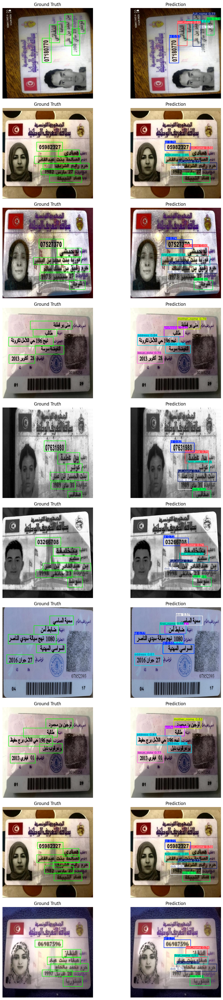

In [ ]:

# Function to draw bounding boxes from YOLO annotation format
def draw_bboxes(img, annotations, color=(0, 255, 0)):
    """Draw bounding boxes on the image based on YOLO annotations."""
    for annotation in annotations:
        # Extract the coordinates (YOLO format: x_center, y_center, width, height)
        x_center, y_center, width, height = annotation
        x1 = int((x_center - width / 2) * img.shape[1])
        y1 = int((y_center - height / 2) * img.shape[0])
        x2 = int((x_center + width / 2) * img.shape[1])
        y2 = int((y_center + height / 2) * img.shape[0])

        # Draw the bounding box
        cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
    return img

# Function to load YOLO annotations from file (in YOLO format)
def load_yolo_annotations(label_file):
    annotations = []
    with open(label_file, 'r') as file:
        for line in file:
            # Each line corresponds to one object, with YOLO format: class_id x_center y_center width height
            parts = line.strip().split()
            if len(parts) == 5:  # Only consider valid lines with 5 elements (class_id and bbox)
                x_center, y_center, width, height = map(float, parts[1:])
                annotations.append([x_center, y_center, width, height])
    return annotations

# Function to test model and compare results
def test_detection_model(model, image_paths, label_dir, num_samples=5):
    """Test the trained model on some validation images and compare with ground truth."""
    # Select random samples from validation set
    test_samples = random.sample(image_paths, min(num_samples, len(image_paths)))

    # Set up the figure
    fig, axes = plt.subplots(len(test_samples), 2, figsize=(12, 4 * len(test_samples)))

    for i, img_path in enumerate(test_samples):
        # Load the image
        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Load ground truth annotations (YOLO format)
        label_path = Path(label_dir) / (Path(img_path).stem + '.txt')
        ground_truth = load_yolo_annotations(label_path)

        # Draw ground truth bounding boxes
        img_gt = draw_bboxes(img_rgb.copy(), ground_truth, color=(0, 255, 0))

        # Display ground truth
        axes[i, 0].imshow(img_gt)
        axes[i, 0].set_title("Ground Truth")
        axes[i, 0].axis('off')

        # Run inference and get predicted bounding boxes
        results = model(img_path)
        pred_img = results[0].plot()  # Plot predictions on image

        # Convert prediction image to RGB
        pred_img_rgb = cv2.cvtColor(pred_img, cv2.COLOR_BGR2RGB)

        # Display predictions
        axes[i, 1].imshow(pred_img_rgb)
        axes[i, 1].set_title("Prediction")
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

# Load the trained YOLOv8 model
model_path = 'runs/detect/train/weights/best.pt'  # Adjust path if needed
detection_model = YOLO(model_path)

# Paths to the validation images and labels
valid_images_dir = '/content/drive/MyDrive/CIN/datasetCIN/valid/images'    # Adjust path
valid_labels_dir = '/content/drive/MyDrive/CIN/datasetCIN/valid/labels'  # Adjust path

# Get the list of all image files in the validation folder
valid_image_paths = list(Path(valid_images_dir).glob('*.jpg'))  # Or adjust extension if needed

# Test and compare predictions
test_detection_model(detection_model, valid_image_paths, valid_labels_dir, num_samples=10)


In [ ]:
model = YOLO('runs/detect/train/weights/best.pt')


model.train(
    data='/content/drive/MyDrive/CIN/datasetCIN/dataset.yaml',
    epochs=20,
    batch=16,
    imgsz=640,
    device=0
)

Ultralytics 8.3.102 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=runs/detect/train/weights/best.pt, data=/content/drive/MyDrive/CIN/datasetCIN/dataset.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False

train: Scanning /content/drive/MyDrive/CIN/datasetCIN/train/labels.cache... 1077 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1077/1077 [00:00<?, ?it/s]

WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 34, len(boxes) = 6107. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/CIN/datasetCIN/valid/labels.cache... 94 images, 0 backgrounds, 0 corrupt: 100%|██████████| 94/94 [00:00<?, ?it/s]

WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 6, len(boxes) = 545. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.16G      1.456     0.7747      1.317         41        640: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.12it/s]

                   all         94        545      0.893      0.943      0.954      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.63G      1.464      0.817      1.317         54        640: 100%|██████████| 68/68 [00:24<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]

                   all         94        545       0.93      0.942      0.951      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.64G      1.495     0.8439      1.345         49        640: 100%|██████████| 68/68 [00:23<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]

                   all         94        545      0.895       0.96       0.95      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.65G      1.493     0.8275      1.329         26        640: 100%|██████████| 68/68 [00:23<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.69it/s]

                   all         94        545      0.854      0.954      0.928      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.66G      1.501     0.8181      1.349         65        640: 100%|██████████| 68/68 [00:22<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.53it/s]

                   all         94        545      0.895      0.939      0.942      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      2.66G      1.484      0.831      1.343         33        640: 100%|██████████| 68/68 [00:23<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.40it/s]

                   all         94        545      0.921      0.921       0.94      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.66G      1.473     0.8162       1.33         38        640: 100%|██████████| 68/68 [00:24<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.10it/s]

                   all         94        545      0.913      0.926      0.953      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.68G      1.468     0.7926      1.331         46        640: 100%|██████████| 68/68 [00:24<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.82it/s]

                   all         94        545      0.886      0.923      0.939      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.68G      1.453     0.7892      1.323         36        640: 100%|██████████| 68/68 [00:23<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.17it/s]

                   all         94        545      0.902      0.932      0.949      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.68G       1.46      0.793      1.325         26        640: 100%|██████████| 68/68 [00:25<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.39it/s]

                   all         94        545      0.916       0.93      0.959      0.538


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20       2.7G      1.465     0.7321        1.4         28        640: 100%|██████████| 68/68 [00:24<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.12it/s]

                   all         94        545      0.904      0.952      0.949      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20       2.7G       1.46     0.7159      1.407         26        640: 100%|██████████| 68/68 [00:21<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.64it/s]

                   all         94        545        0.9      0.949      0.935      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20       2.7G      1.442     0.6943      1.382         29        640: 100%|██████████| 68/68 [00:22<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.43it/s]

                   all         94        545      0.907       0.96      0.962       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.71G      1.439     0.6836       1.39         28        640: 100%|██████████| 68/68 [00:23<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.26it/s]

                   all         94        545       0.91      0.938      0.953      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.71G      1.428      0.672      1.374         29        640: 100%|██████████| 68/68 [00:23<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.50it/s]

                   all         94        545      0.896      0.941      0.951       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.73G      1.404     0.6593      1.368         28        640: 100%|██████████| 68/68 [00:21<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.11it/s]

                   all         94        545      0.872      0.955      0.942      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.73G      1.396     0.6466      1.359         27        640: 100%|██████████| 68/68 [00:22<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.63it/s]

                   all         94        545      0.906      0.953      0.958      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.73G      1.392     0.6375      1.359         28        640: 100%|██████████| 68/68 [00:22<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.20it/s]

                   all         94        545      0.915      0.936      0.957      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.75G      1.387     0.6388      1.357         29        640: 100%|██████████| 68/68 [00:22<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]

                   all         94        545       0.89      0.956       0.95      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.75G      1.373     0.6238       1.35         29        640: 100%|██████████| 68/68 [00:21<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.66it/s]

                   all         94        545      0.892      0.954      0.952      0.531



20 epochs completed in 0.144 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.102 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,598 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.07it/s]


                   all         94        545       0.91      0.938      0.953      0.548
                    Id         75         75      0.926          1      0.987      0.577
               address         18         36      0.845      0.944      0.964      0.562
                   dob         76         77      0.941      0.987      0.988      0.648
            first_name         76         77      0.817      0.896      0.905      0.474
             full_name         76         76      0.968          1      0.995      0.605
            issue_date         18         18          1      0.923      0.995       0.71
             last_name         76         76      0.954      0.961      0.971      0.513
           mother_name         17         18      0.868      0.833      0.878      0.499
                   pob         75         75      0.948      0.972      0.981      0.502
            profession         17         17      0.831      0.866       0.87      0.393
Speed: 0.2ms preproce

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7af68cb7e450>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.0

In [ ]:
model_path = 'runs/detect/train2/weights/best.pt'
detection_model = YOLO(model_path)
# Run inference on the validation set
results = detection_model.predict(
    source='/content/drive/MyDrive/CIN/datasetCIN/valid/images',
    save=True,
    conf=0.25,
    imgsz=640
)


image 1/94 /content/drive/MyDrive/CIN/datasetCIN/valid/images/C10_jpg.rf.8d2e328c5e8b9c8aa39ab73dd22063e9.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.2ms
image 2/94 /content/drive/MyDrive/CIN/datasetCIN/valid/images/C13_jpg.rf.8ba84b63f151073254f89e20d8200ddb.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 9.7ms
image 3/94 /content/drive/MyDrive/CIN/datasetCIN/valid/images/C16_jpg.rf.567ec4da568e1eaad697c711a9df1dfd.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 10.9ms
image 4/94 /content/drive/MyDrive/CIN/datasetCIN/valid/images/C17_jpg.rf.dea80efc5923f9dd55b90500d81214df.jpg: 640x640 3 addresss, 1 issue_date, 1 mother_name, 7.3ms
image 5/94 /content/drive/MyDrive/CIN/datasetCIN/valid/images/C7_jpg.rf.c423ea7f77c21e1a000d742b7cc75046.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 8.5ms
image 6/94 /content/drive/MyDrive/CIN/datasetCIN/valid/images/IMG_2677_jpg.rf.05509de6dda07a7

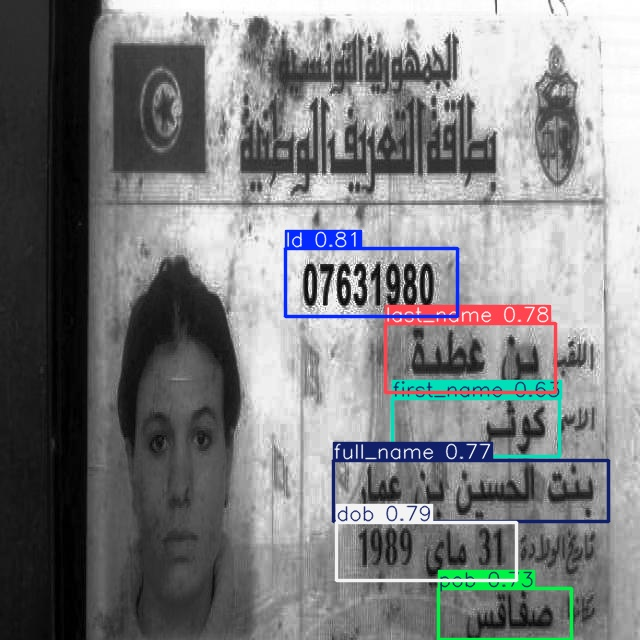

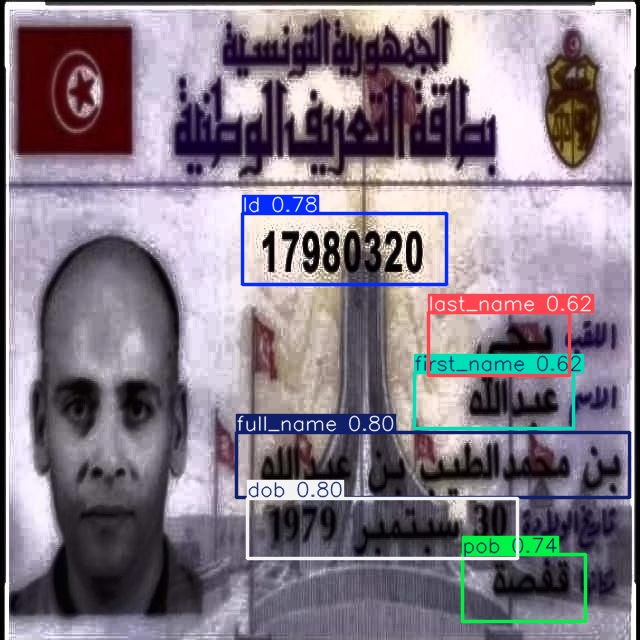

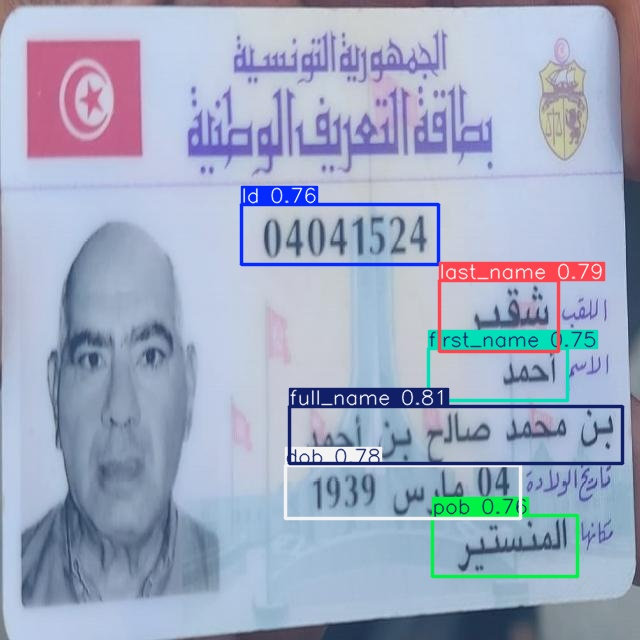

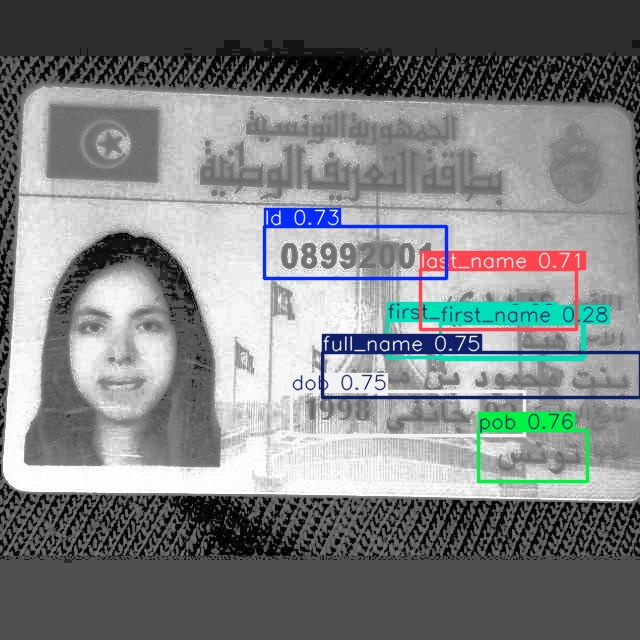

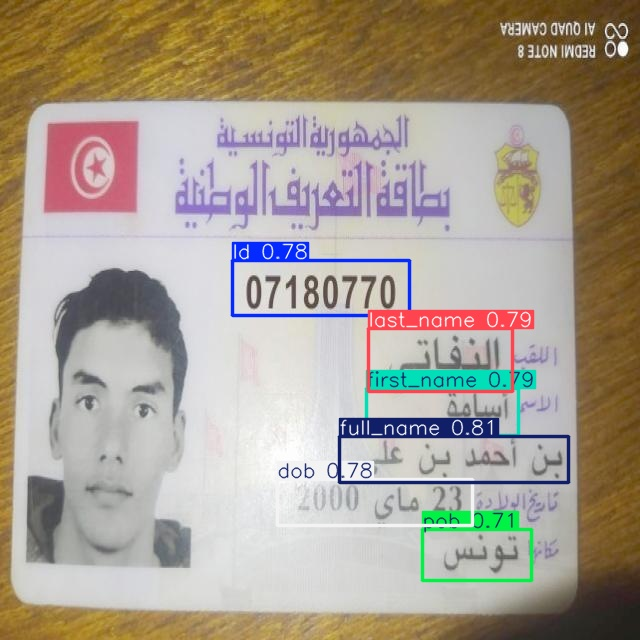

In [ ]:
# Path to predicted images
pred_dir = 'runs/detect/predict'

# Display a few prediction images
for image_name in os.listdir(pred_dir)[:5]:  # show first 5
    display(Image(filename=os.path.join(pred_dir, image_name)))



image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin18_jpg.rf.080dbfd3c32dfa122ae30391c456160b.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.4ms
Speed: 2.1ms preprocess, 7.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


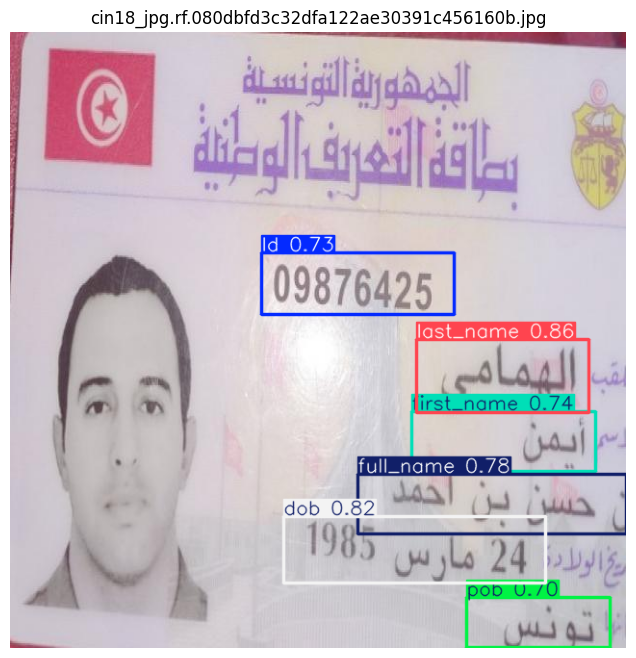


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin63_jpg.rf.75adc54e726e58e00a28efc6a42f03e8.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.4ms
Speed: 2.0ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


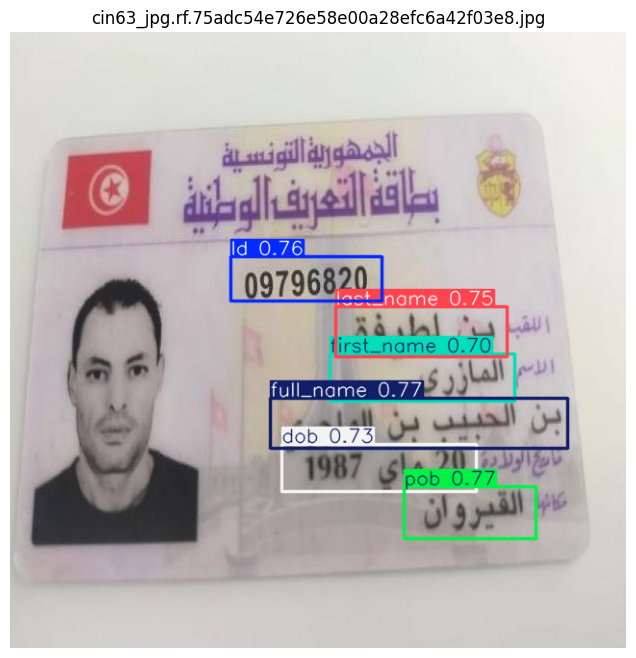


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin4_back_jpg.rf.fc15b8a13e9f972ac994f301ba3f520c.jpg: 640x640 2 addresss, 1 issue_date, 1 mother_name, 1 profession, 7.5ms
Speed: 2.1ms preprocess, 7.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


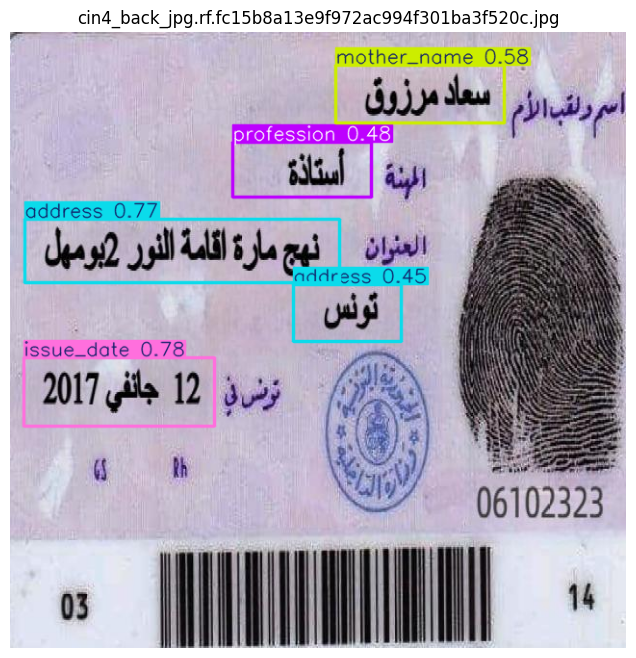


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/fairy-lights-background-designify-1-_png_jpg.rf.4541ccab0bfe29642f0cd848f22b6841.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 8.7ms
Speed: 2.9ms preprocess, 8.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


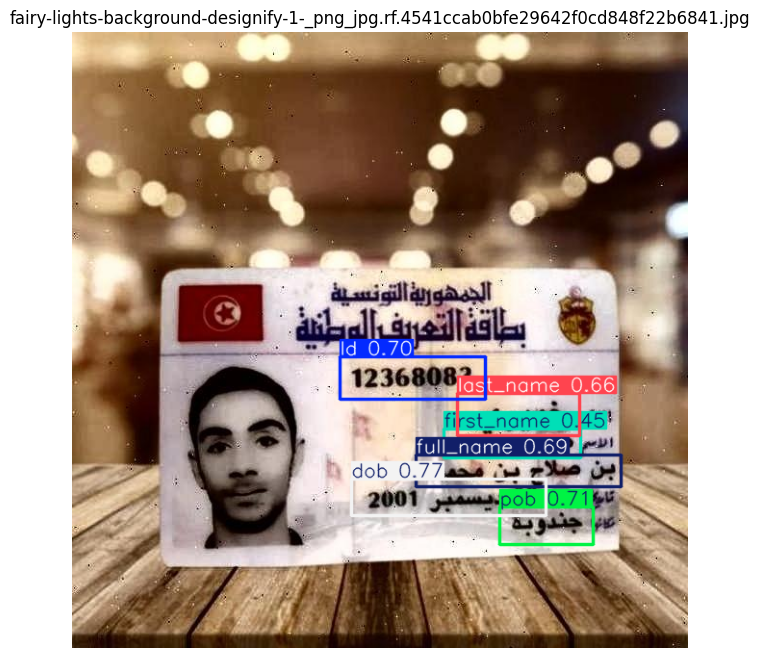


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin33_jpg.rf.c9d1628bb4f49f28faee5d26c2a07189.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 12.5ms
Speed: 2.8ms preprocess, 12.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


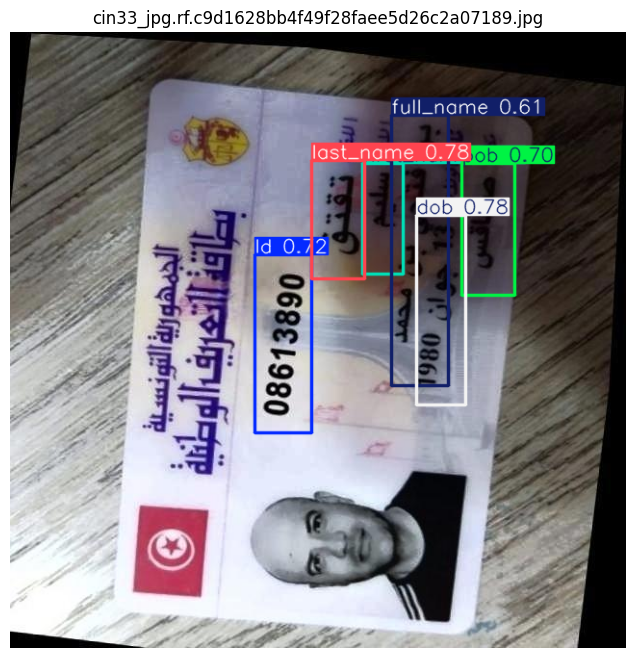


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/C8_jpg.rf.b8a7265602964c4934888058eca0d994.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.4ms
Speed: 2.0ms preprocess, 7.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


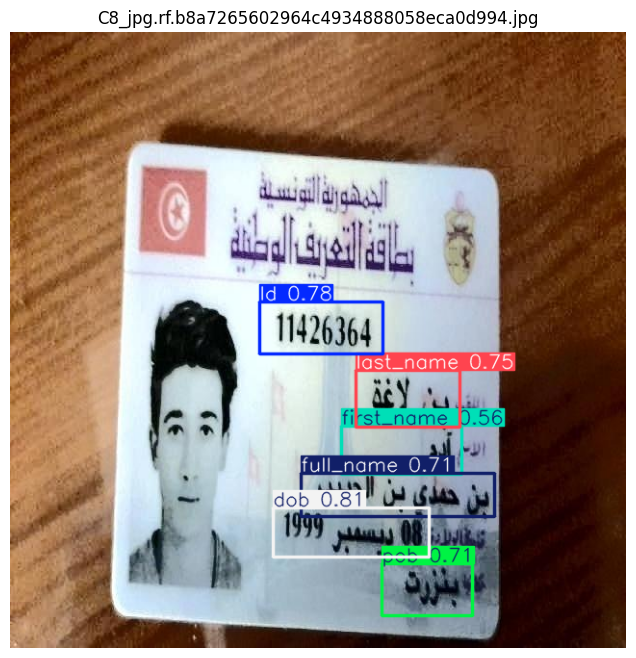


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin49_back_jpg.rf.e0e3a538cfea6c3f2a8ec64b892318f9.jpg: 640x640 2 addresss, 1 issue_date, 1 mother_name, 1 profession, 7.3ms
Speed: 2.1ms preprocess, 7.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


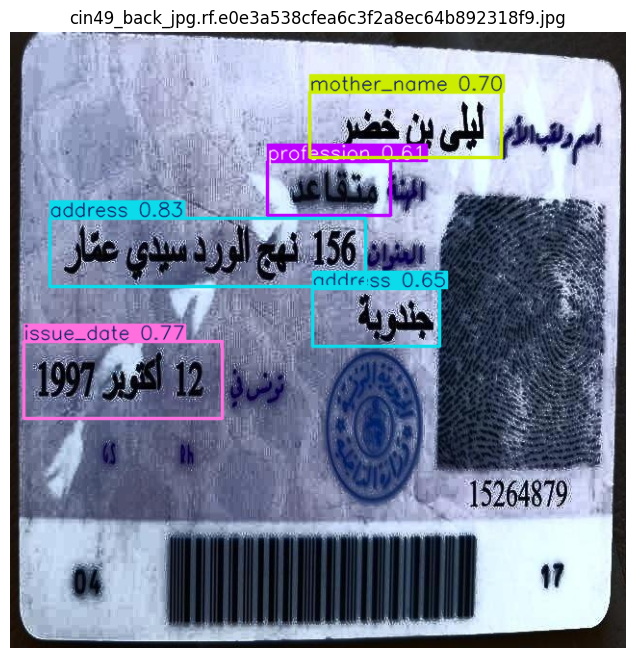


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin39_jpg.rf.f1713f0f0743aeb1a6ba5fd48bbd6832.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.5ms
Speed: 2.0ms preprocess, 7.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


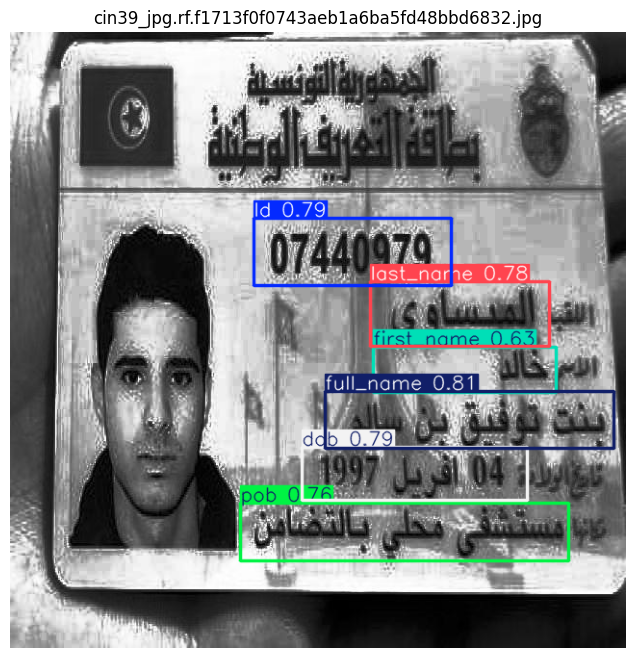


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin183_jpg.rf.3e5b7a185b4f4420119fdf9ae611e113.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 8.1ms
Speed: 2.3ms preprocess, 8.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


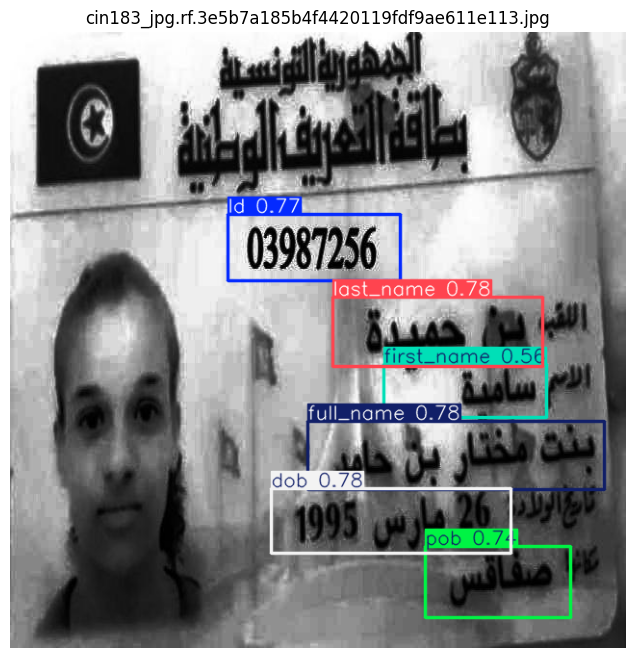


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin69_jpg.rf.7b3b7fc3ea3cec8f7a1d187ac33f7cce.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.5ms
Speed: 2.0ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


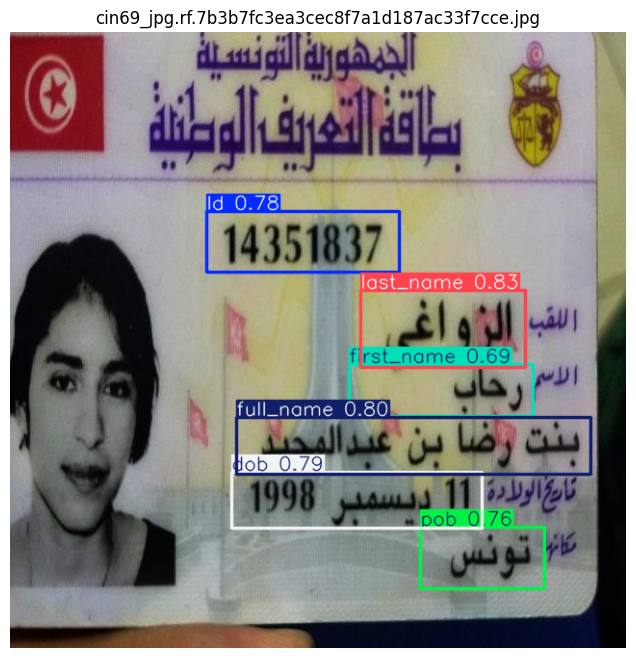


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin95_jpg.rf.c722db6f8214fdbe35983f31ce41a898.jpg: 640x640 1 Id, 1 dob, 2 first_names, 1 full_name, 1 last_name, 1 pob, 7.3ms
Speed: 2.0ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


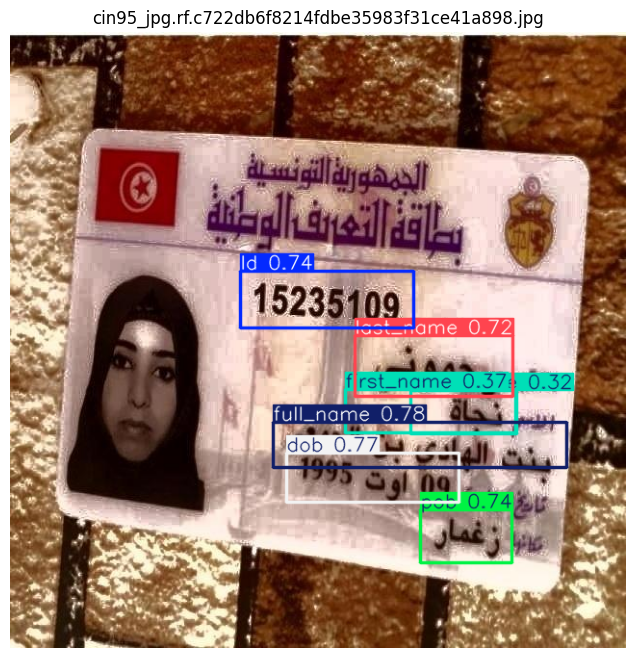


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/fairy-lights-background-designify-1-_png_jpg.rf.e9af1a1da6290557812aa68ec370edda.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.6ms
Speed: 2.1ms preprocess, 7.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


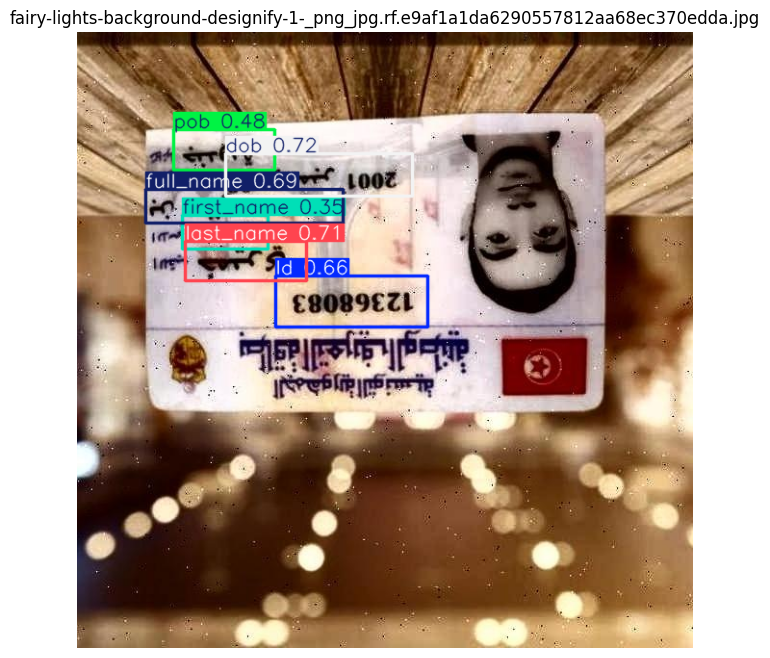


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin64_jpg.rf.5b802809abc52e4368e4e8b51ee0a8b8.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.4ms
Speed: 2.1ms preprocess, 7.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


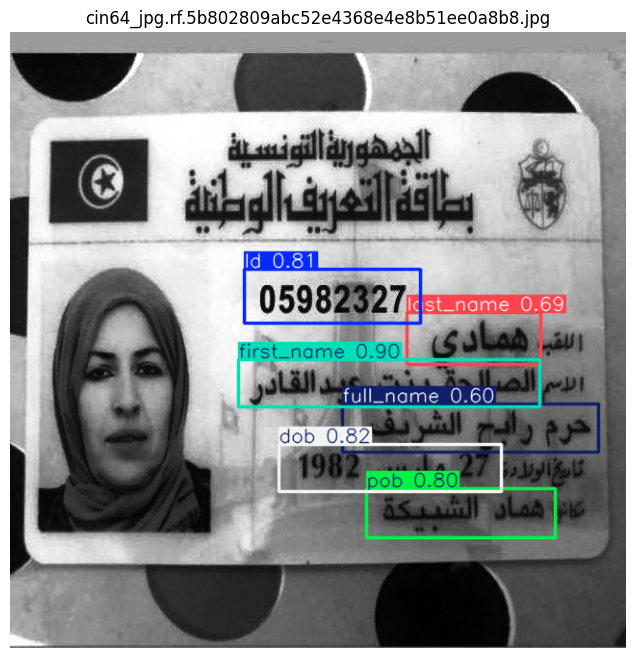


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin49_back_jpg.rf.6704d95bab6daa7b0648dd86e209fc43.jpg: 640x640 2 addresss, 1 issue_date, 1 mother_name, 1 profession, 7.5ms
Speed: 2.1ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


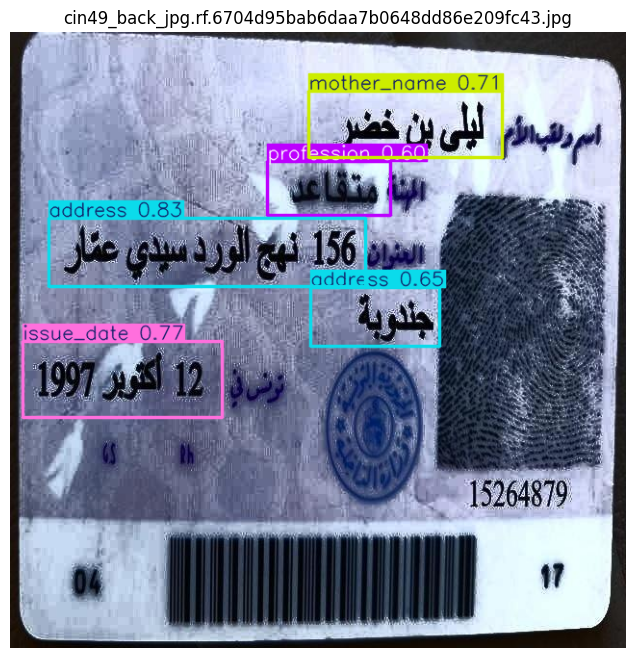


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin36_back_jpg.rf.48c764d93169489e6752d3e27d0469cc.jpg: 640x640 2 addresss, 1 issue_date, 1 mother_name, 2 professions, 7.4ms
Speed: 2.0ms preprocess, 7.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


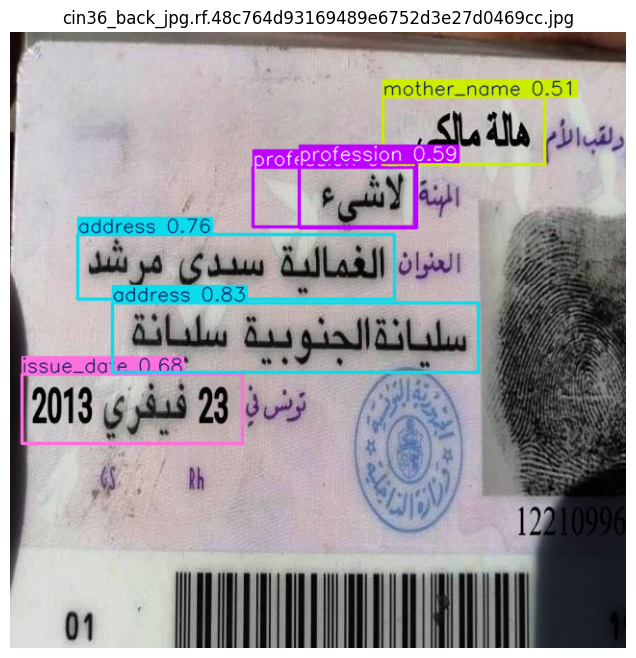


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin17_jpg.rf.40d7ff7f3506ae1ec8e4c2540842ecc0.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 9.0ms
Speed: 3.0ms preprocess, 9.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


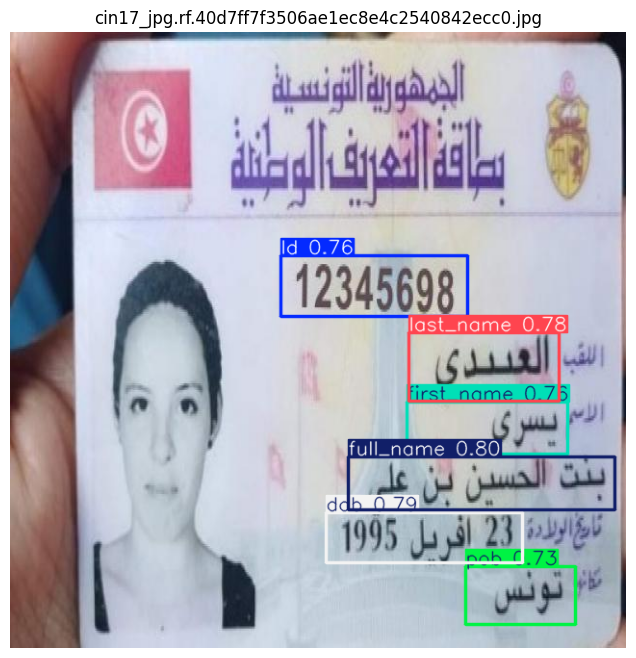


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/wooden-table-designify_png_jpg.rf.8b4096de1256ad07e2c0750a12e1c27e.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 11.4ms
Speed: 2.8ms preprocess, 11.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


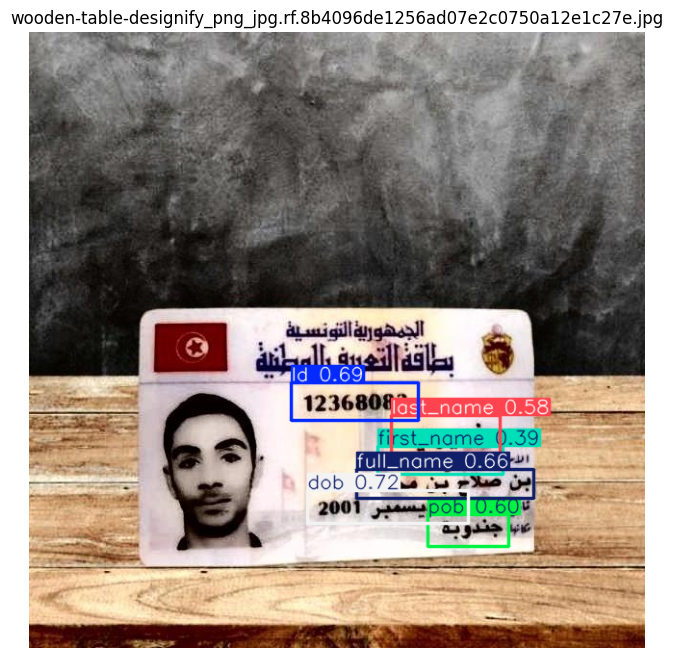


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin95_jpg.rf.91f3a77fd8fcc8416991b2e8425854cb.jpg: 640x640 1 Id, 1 dob, 2 first_names, 1 full_name, 1 last_name, 1 pob, 7.4ms
Speed: 2.8ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


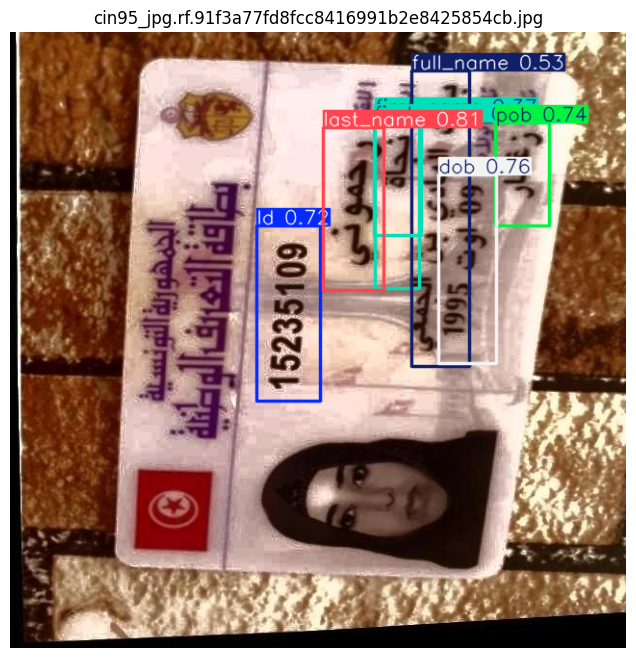


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/concrete-floor-designify_png.rf.d5231fe08538d07c2acffb6e646157f8.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.4ms
Speed: 2.2ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


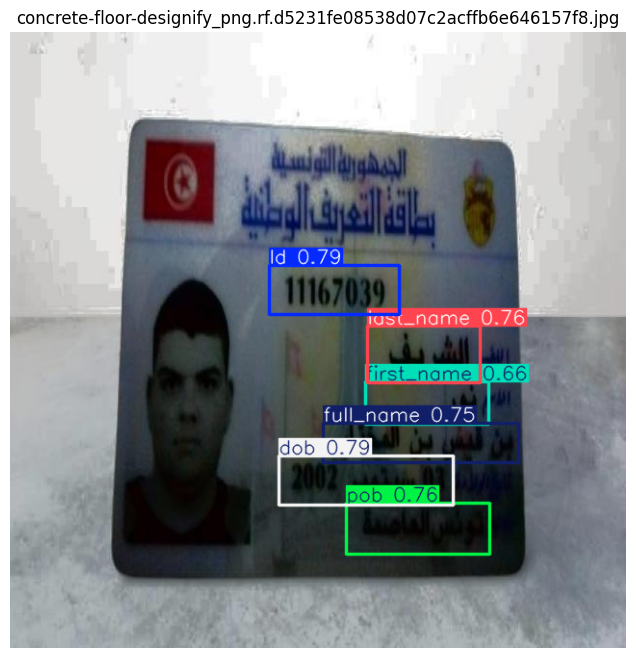


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin18_jpg.rf.ab38900dc045f01f33976083f3b191fc.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.9ms
Speed: 2.2ms preprocess, 7.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


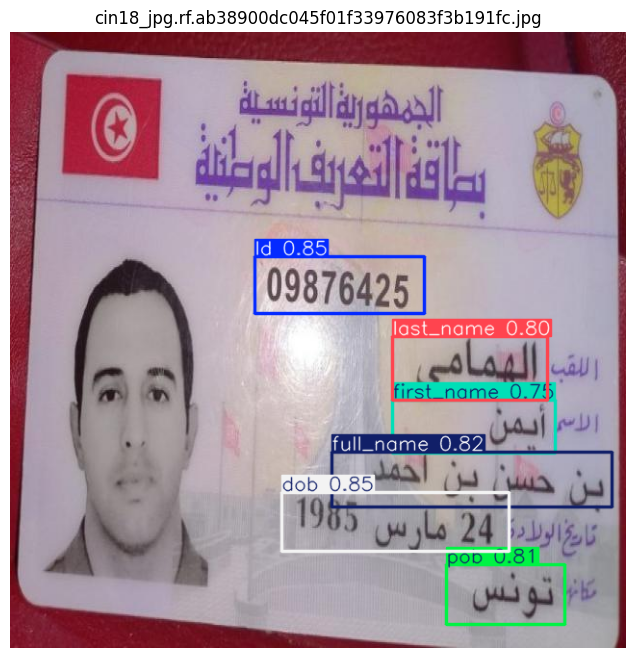


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/wooden-table-designify_png.rf.cfdefe53b28241651091b1415b38e461.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.3ms
Speed: 2.1ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


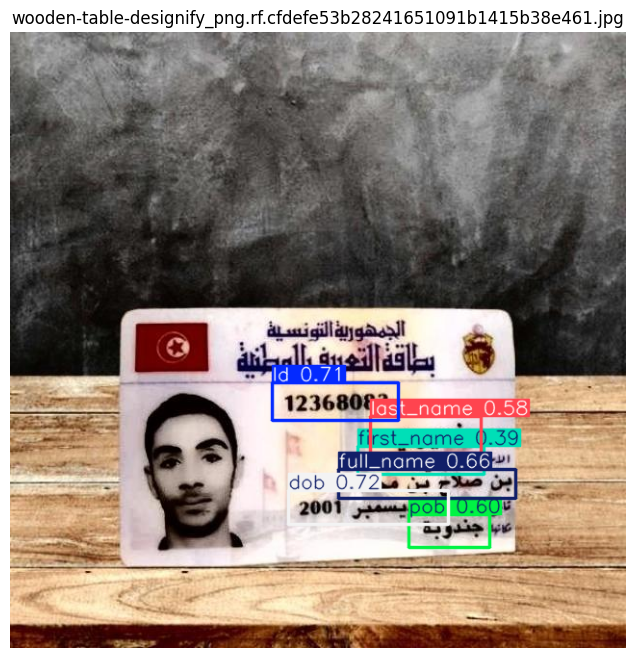


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin144_jpg.rf.8e6275b5e5114fa7f0b98a98f9470b34.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.7ms
Speed: 2.0ms preprocess, 7.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


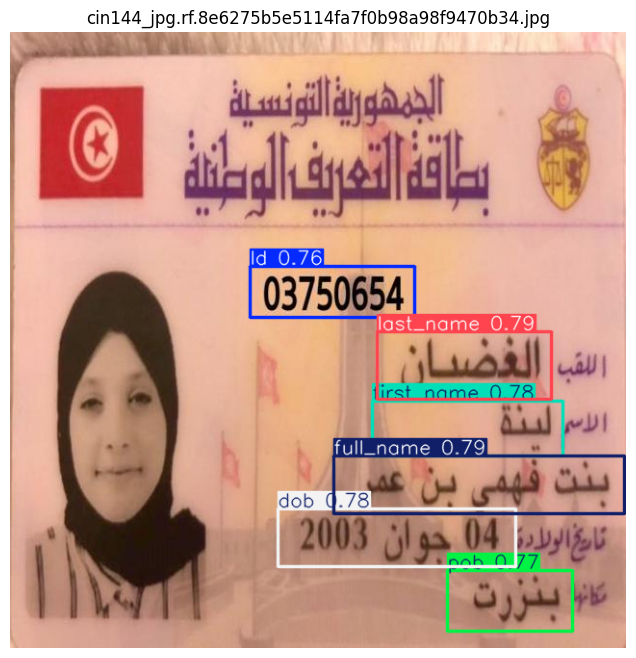


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin38_jpg.rf.05cd0d3524fb3adbf24d5a238bb6d2ee.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 8.2ms
Speed: 2.1ms preprocess, 8.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


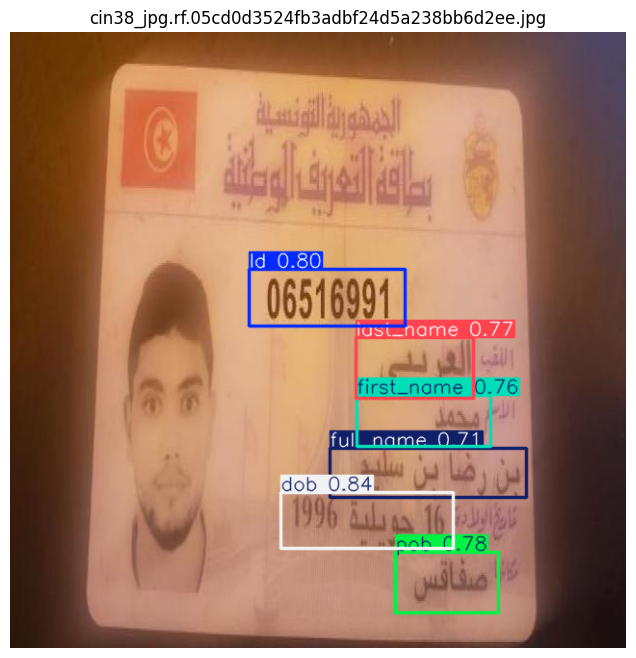


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin2_jpg.rf.5d51f0b5f54ff8815c028e875854b976.jpg: 640x640 1 Id, 1 dob, 2 first_names, 1 full_name, 1 last_name, 1 pob, 7.6ms
Speed: 2.2ms preprocess, 7.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


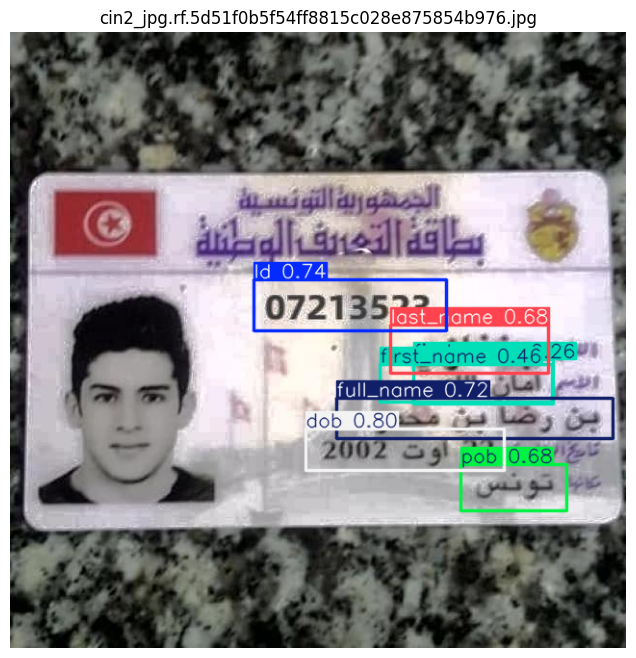


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/parking-garage-background-designify-2-_png_jpg.rf.656e5e57a7f647e65765e4700ea526df.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.4ms
Speed: 2.0ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


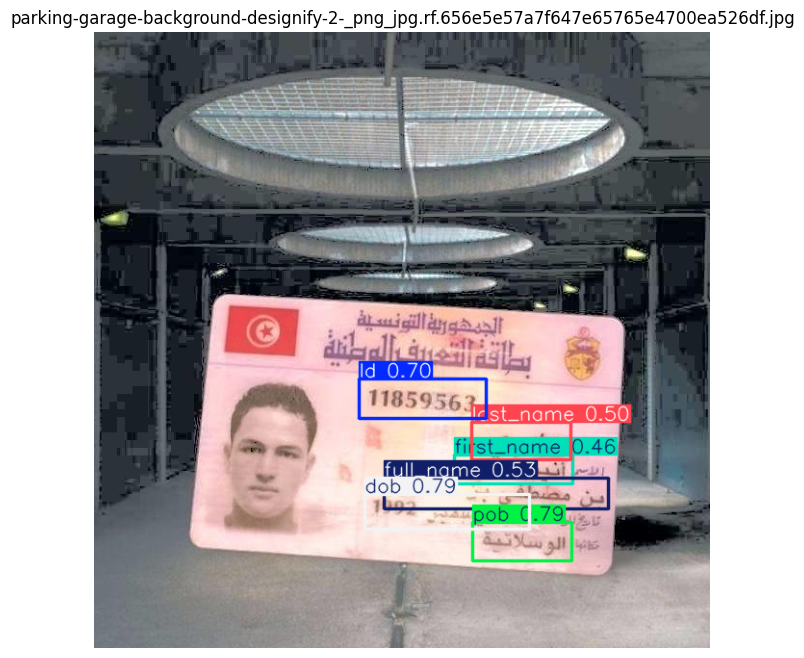


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/parking-garage-background-designify-3-_png_jpg.rf.b54843f8562fe681c42bb3c2ca8b484b.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 7.9ms
Speed: 2.0ms preprocess, 7.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


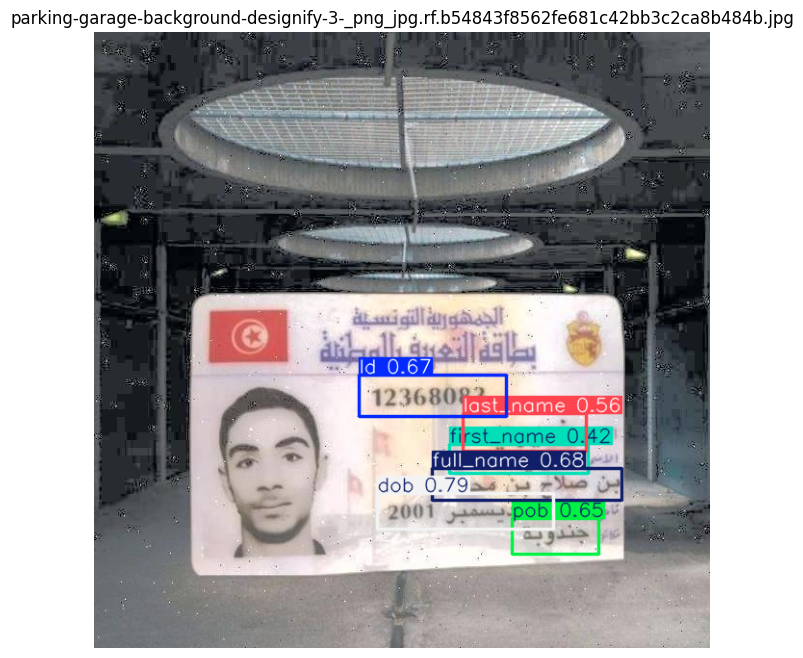


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin13_jpg.rf.227a0454e72e279e85a47eda479564e2.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 10.4ms
Speed: 2.8ms preprocess, 10.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


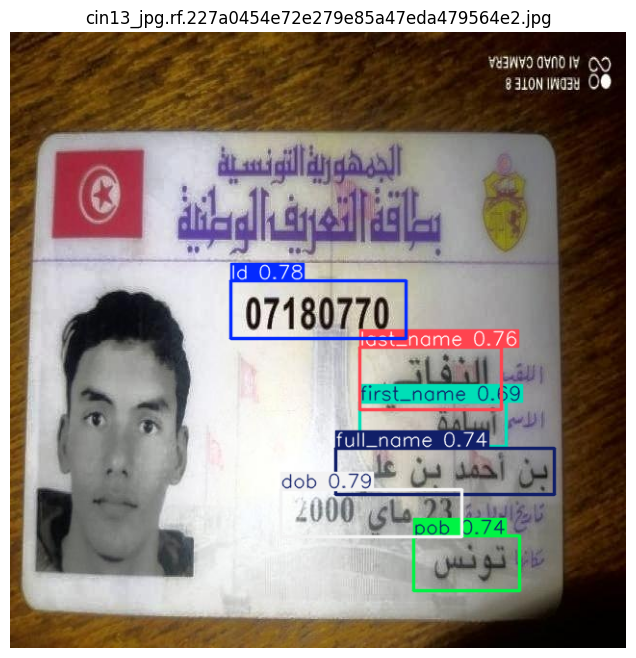


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin19_jpg.rf.fff7779a3d153c370a3b99ebec75f2b8.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 17.8ms
Speed: 3.1ms preprocess, 17.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


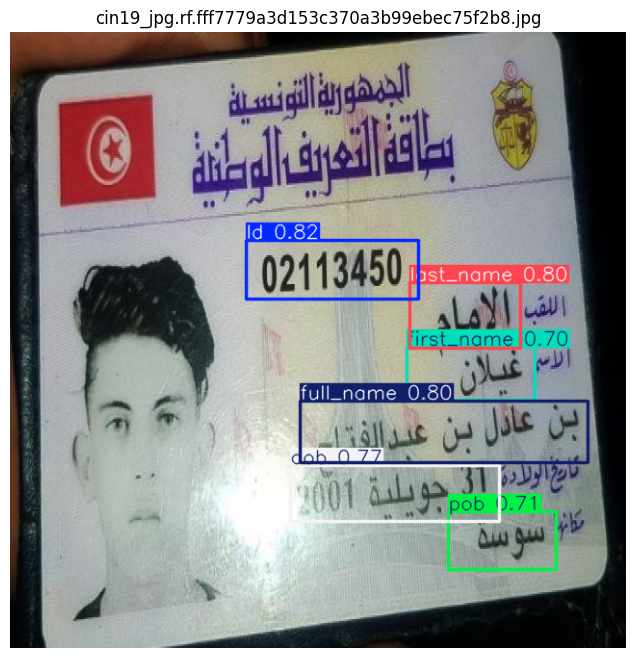


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin59_jpg.rf.5a454972a8ed626eea1ed52b1591175e.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 10.6ms
Speed: 2.9ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


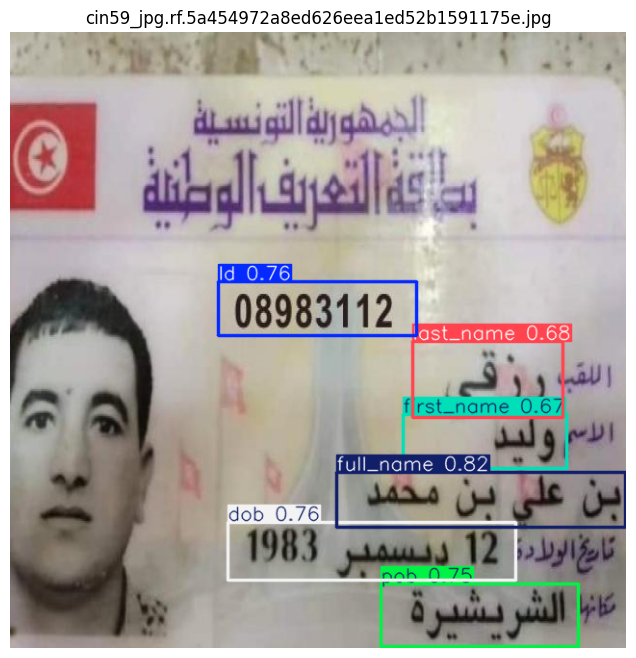


image 1/1 /content/drive/MyDrive/CIN/datasetCIN/test/images/cin163_jpg.rf.cab708e6bc0580338f24f67257820275.jpg: 640x640 1 Id, 1 dob, 1 first_name, 1 full_name, 1 last_name, 1 pob, 12.8ms
Speed: 2.7ms preprocess, 12.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


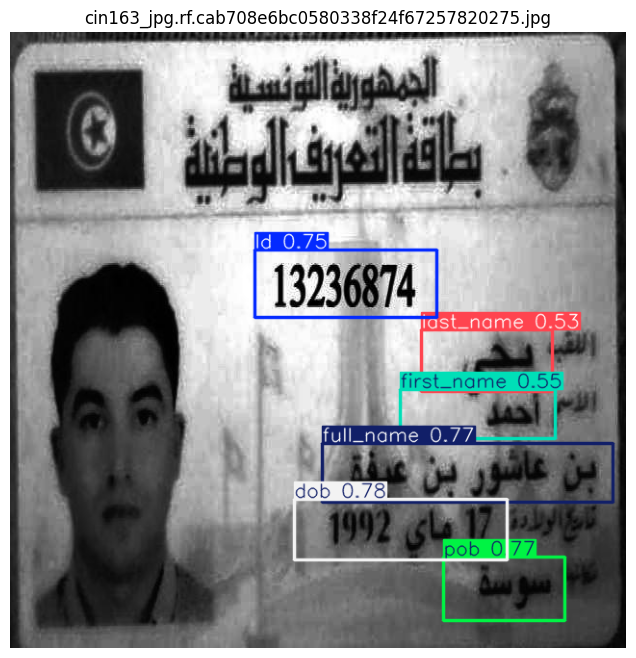

In [ ]:
# Get test image paths
test_images_dir = '/content/drive/MyDrive/CIN/datasetCIN/test/images'
test_image_paths = list(Path(test_images_dir).glob('*.jpg'))

# Loop through test images and show predictions
for img_path in test_image_paths:
    results = detection_model(str(img_path))  # Run prediction
    res_plotted = results[0].plot()           # Draw boxes on the image

    # Show the image with predictions
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(res_plotted, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(img_path.name)
    plt.show()


In [ ]:
exported_model_path = detection_model.export(format="onnx")

# Print the actual saved path
print(f"Model saved to {exported_model_path}")


Ultralytics 8.3.102 🚀 Python-3.11.11 torch-2.6.0+cu124 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/train2/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 14, 8400) (6.0 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0', 'onnxslim', 'onnxruntime-gpu'] not found, attempting AutoUpdate...


ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.49...
ONNX: export success ✅ 11.7s, saved as 'runs/detect/train2/weights/best.onnx' (11.7 MB)

Export complete (13.4s)
Results saved to /content/runs/detect/train2/weights
Predict:         yolo predict task=detect model=runs/detect/train2/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=runs/detect/train2/weights/best.onnx imgsz=640 data=/content/drive/MyDrive/CIN/datasetCIN/dataset.yaml  
Visualize:       https://netron.app
Model saved to runs/detect/train2/weights/best.onnx


In [ ]:
import shutil

# Mount Google Drive to your Colab environment
drive.mount('/content/drive')

# Path to the fine-tuned model (best.pt)
model_path = 'runs/detect/train2/weights/best.pt'  # adjust if needed

# Destination path in Google Drive
drive_model_path = '/content/drive/MyDrive/CIN/best_finetuned.pt'  # change as needed

# Move the model to Google Drive
shutil.copy(model_path, drive_model_path)

print(f"Model saved to Google Drive at {drive_model_path}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Model saved to Google Drive at /content/drive/MyDrive/CIN/best_finetuned.pt
